# Prepare grids for gravity inversion

import the necessary packages

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2
import os

import numpy as np
import xarray as xr
import zarr
from polartoolkit import fetch, maps, regions, utils

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

# Set region 
define parameters to use for preparing the grids

In [2]:
region = [-960e3, 800e3, -1800e3, -60e3]
spacing = 1000
registration = "g"
reference = "ellipsoid"

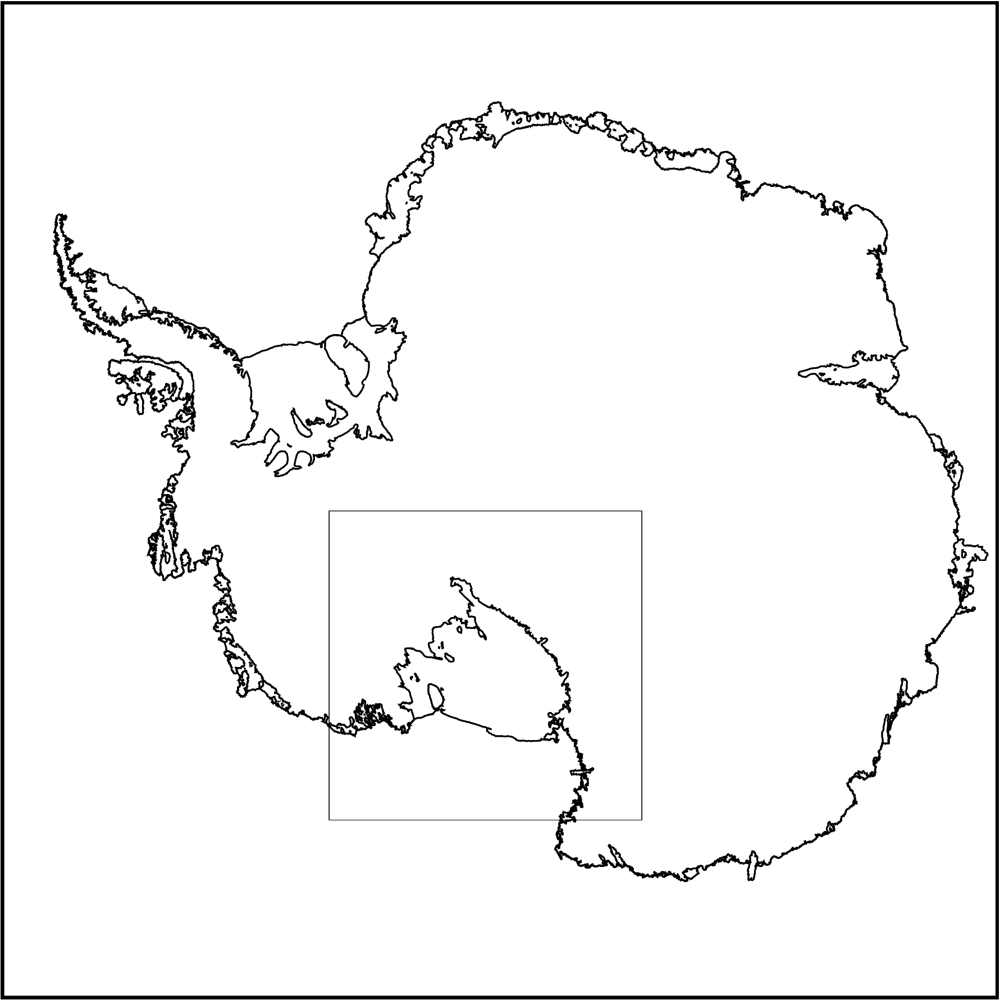

In [3]:
fig = maps.basemap(
    coast=True,
    region=regions.antarctica,
    show_region=region,
)
fig.show()

# Load and save as .zarr files

Load the grids and save the results to .zarr files in `RIS_gravity_inversion/inversion_layers/`

use Antarctic-Plots to fetch data, set the reference frame, change the spacing and region. 

## Ice surface

In [4]:
bedmachine_surface = fetch.bedmachine(
    layer="surface",
    reference=reference,
    region=region,
    spacing=spacing,
    registration=registration,
)

bedmap2_surface = fetch.bedmap2(
    layer="surface",
    reference=reference,
    region=region,
    spacing=spacing,
    registration=registration,
    fill_nans=True,
)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


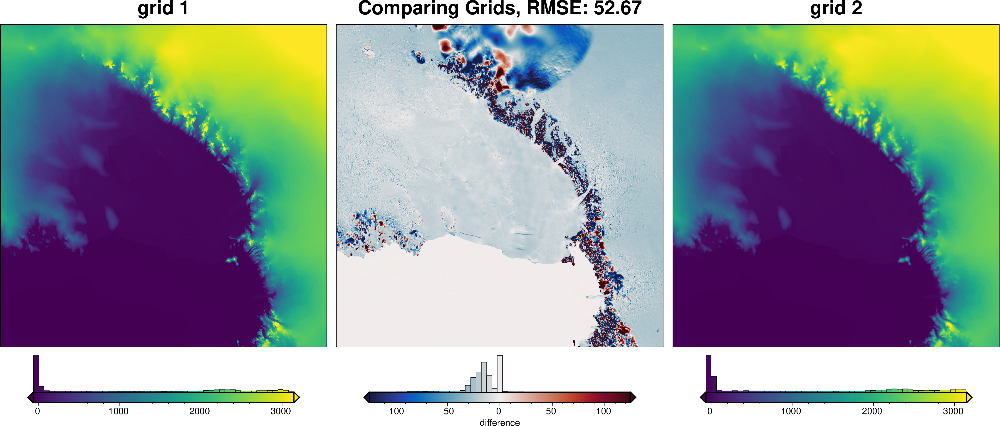

In [ ]:
grids = utils.grd_compare(
    bedmachine_surface,
    bedmap2_surface,
    hist=True,
    robust=True,
)

##  Ice base

In [6]:
bedmachine_icebase = fetch.bedmachine(
    layer="icebase",
    reference=reference,
    region=region,
    spacing=spacing,
    registration=registration,
)

bedmap2_icebase = fetch.bedmap2(
    layer="icebase",
    reference=reference,
    region=region,
    spacing=spacing,
    registration=registration,
    fill_nans=True,
)
# bedmap2_icebase = bedmap2_icebase.fillna(0)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


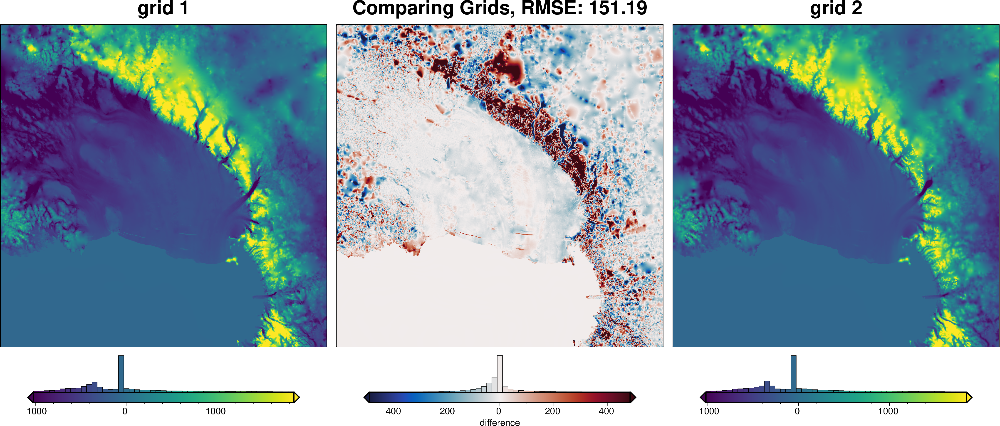

In [ ]:
grids = utils.grd_compare(
    bedmachine_icebase,
    bedmap2_icebase,
    hist=True,
    robust=True,
)

## Bed

In [8]:
bedmachine_bed = fetch.bedmachine(
    layer="bed",
    reference=reference,
    region=region,
    spacing=spacing,
    registration=registration,
)

bedmap2_bed = fetch.bedmap2(
    layer="bed",
    reference=reference,
    region=region,
    spacing=spacing,
    registration=registration,
)

bedmachine_bed_full = fetch.bedmachine(
    layer="bed",
    reference=reference,
    spacing=500,
    registration=registration,
)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


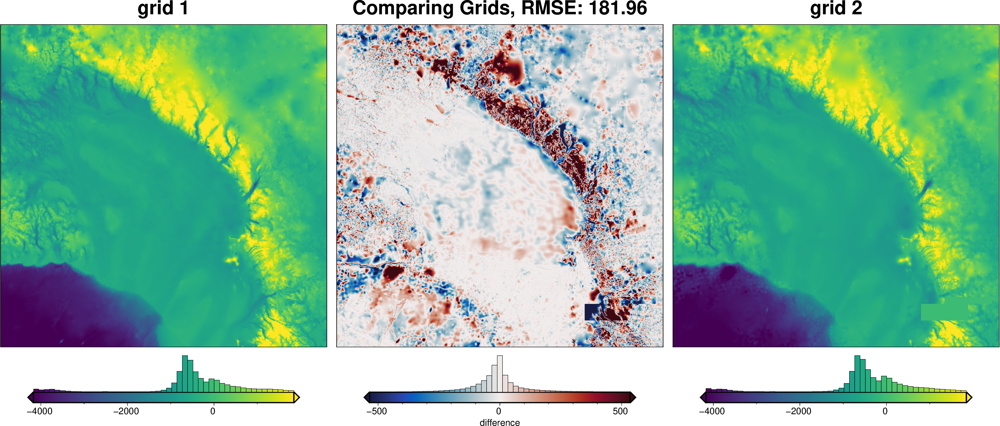

In [ ]:
grids = utils.grd_compare(
    bedmachine_bed,
    bedmap2_bed,
    hist=True,
    robust=True,
)

### Error

In [10]:
bedmachine_bed_error_full = fetch.bedmachine(
    layer="errbed",
    reference=reference,
    spacing=500,
    registration=registration,
)

In [11]:
bedmachine_bed_error = fetch.bedmachine(
    layer="errbed",
    region=region,
    spacing=spacing,
    registration=registration,
)
bedmachine_bed_error_full = fetch.bedmachine(
    layer="errbed",
    reference=reference,
    spacing=500,
    registration=registration,
)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


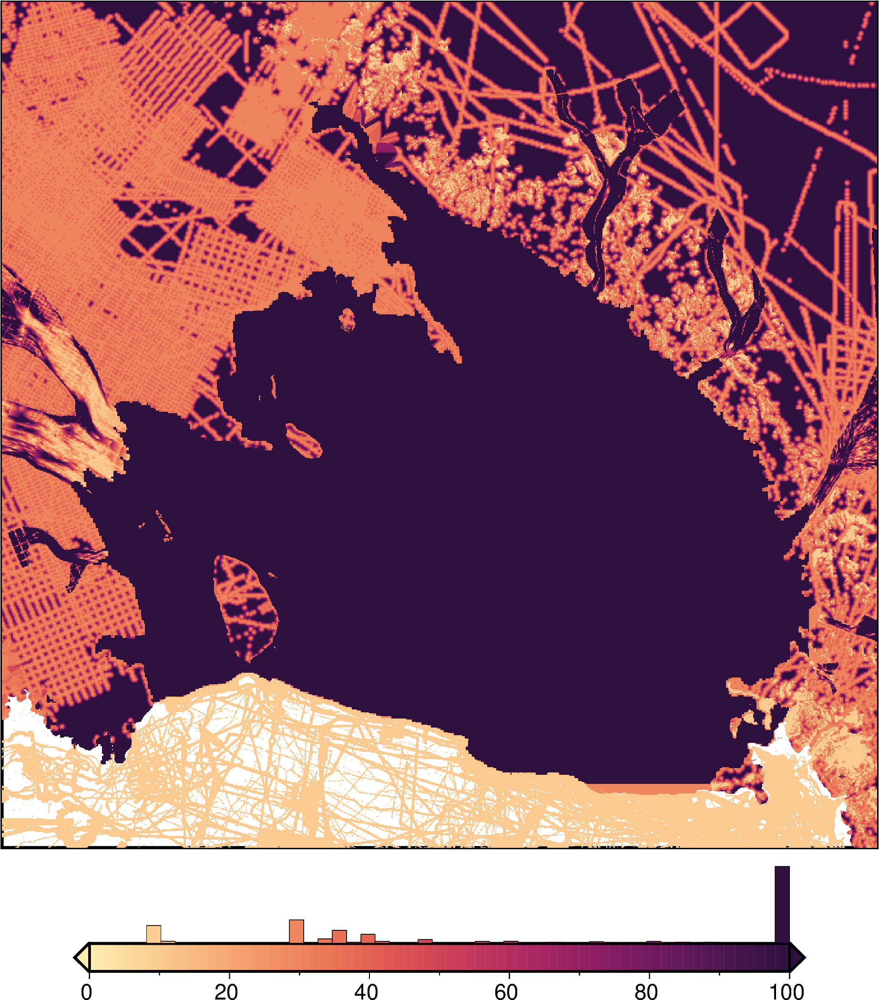

In [ ]:
fig = maps.plot_grd(
    bedmachine_bed_error,
    cmap="matter",
    cpt_lims=[0, 100],
    # robust=True,
    hist=True,
    region=regions.ross_ice_shelf,
)
fig.show()

### Data ID

In [13]:
bedmachine_dataid = fetch.bedmachine(
    layer="dataid",
    region=region,
    spacing=spacing,
    registration=registration,
)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


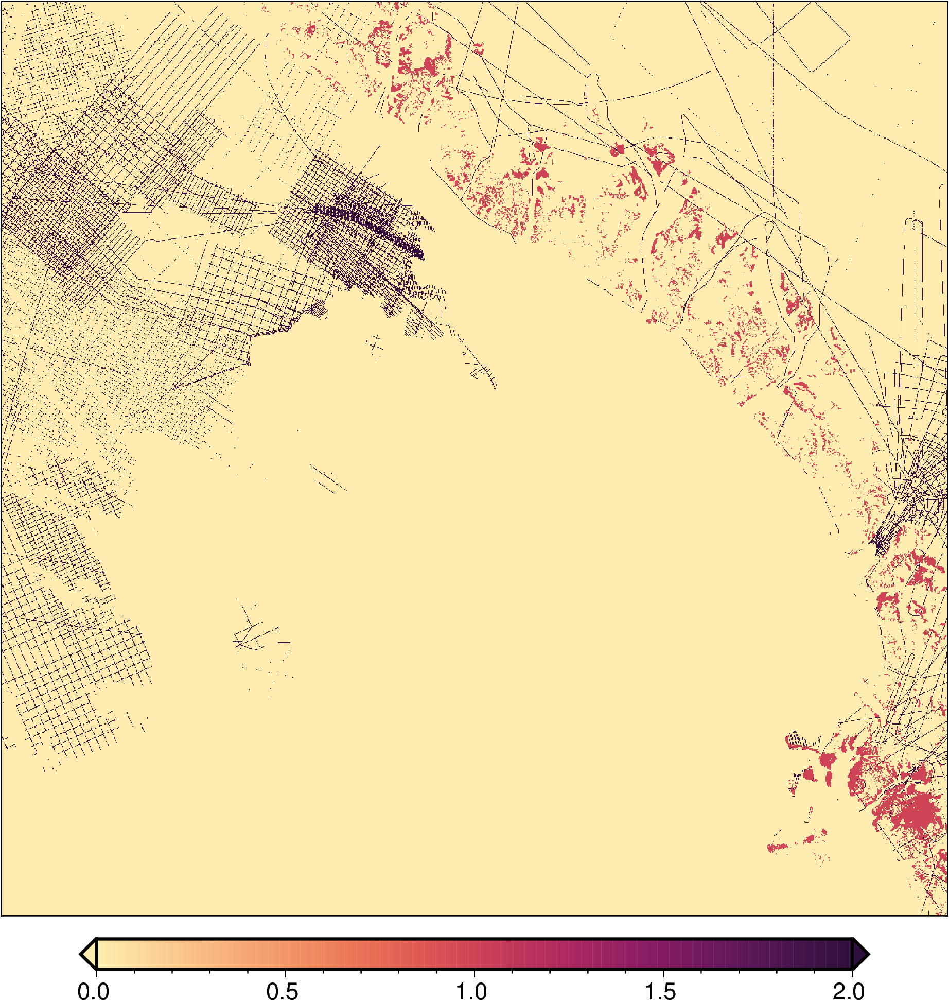

In [ ]:
fig = maps.plot_grd(
    bedmachine_dataid,
    cmap="matter",
    cpt_lims=[0, 2],
    # robust=True,
    region=regions.ross_ice_shelf,
)
fig.show()

### 5km version of bedmachine bed

In [15]:
# bedmachine_bed_5k = fetch.resample_grid(bedmachine_bed, spacing=5e3)
# print("Bedmachine bed 5k info:", utils.get_grid_info(bedmachine_bed_5k))

## Ensure layers don't cross

In [16]:
# anywhere bed is above icebase, set equal to icebase
bedmap2_bed_nocross = xr.where(
    bedmap2_bed > bedmap2_icebase, bedmap2_icebase, bedmap2_bed
)

# anywhere bed is above surface, set equal to surface
bedmap2_bed_nocross = xr.where(
    bedmap2_bed_nocross > bedmap2_surface, bedmap2_surface, bedmap2_bed_nocross
)

# anywhere icebase is above surface, set equal to surface
bedmap2_icebase_nocross = xr.where(
    bedmap2_icebase > bedmap2_surface, bedmap2_surface, bedmap2_icebase
)

# check it worked
assert np.all(bedmap2_surface - bedmap2_icebase_nocross) >= 0
assert np.all(bedmap2_surface - bedmap2_bed_nocross) >= 0
assert np.all(bedmap2_icebase_nocross - bedmap2_bed_nocross) >= 0

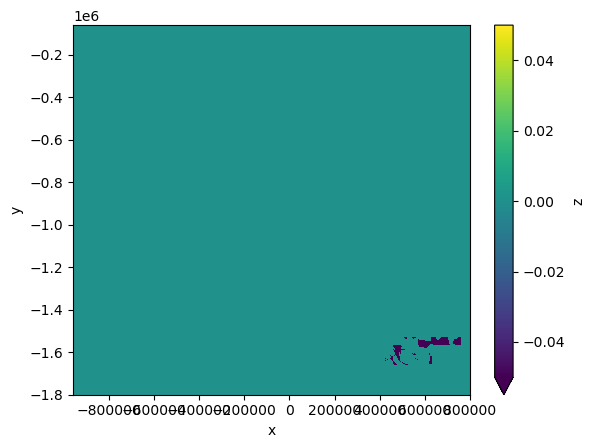

In [17]:
(bedmap2_bed_nocross - bedmap2_bed).plot(robust=True)

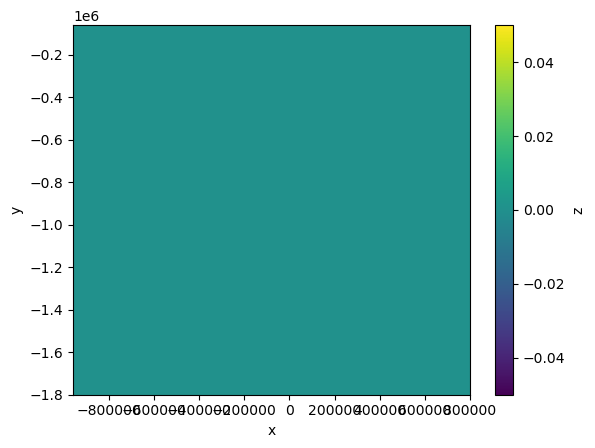

In [18]:
(bedmap2_icebase_nocross - bedmap2_icebase).plot(robust=True)

In [19]:
# anywhere bed is above icebase, set equal to icebase
bedmachine_bed_nocross = xr.where(
    bedmachine_bed > bedmachine_icebase, bedmachine_icebase, bedmachine_bed
)

# anywhere bed is above surface, set equal to surface
bedmachine_bed_nocross = xr.where(
    bedmachine_bed_nocross > bedmachine_surface,
    bedmachine_surface,
    bedmachine_bed_nocross,
)

# anywhere icebase is above surface, set equal to surface
bedmachine_icebase_nocross = xr.where(
    bedmachine_icebase > bedmachine_surface, bedmachine_surface, bedmachine_icebase
)

# check it worked
assert np.all(bedmachine_surface - bedmachine_icebase_nocross) >= 0
assert np.all(bedmachine_surface - bedmachine_bed_nocross) >= 0
assert np.all(bedmachine_icebase_nocross - bedmachine_bed_nocross) >= 0

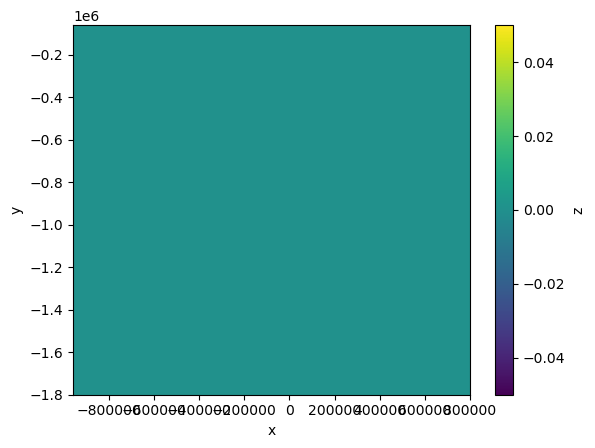

In [20]:
(bedmachine_bed_nocross - bedmachine_bed).plot(robust=True)

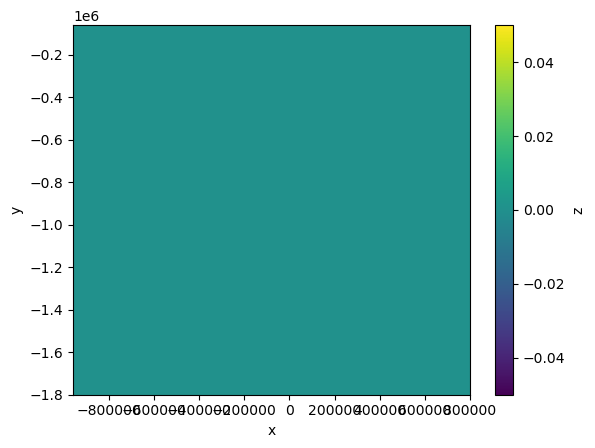

In [21]:
(bedmachine_icebase_nocross - bedmachine_icebase).plot(robust=True)

In [22]:
# reset original grids with un-crossed grids
bedmap2_icebase = bedmap2_icebase_nocross
bedmap2_bed = bedmap2_bed_nocross

bedmachine_icebase = bedmachine_icebase_nocross
bedmachine_bed = bedmachine_bed_nocross

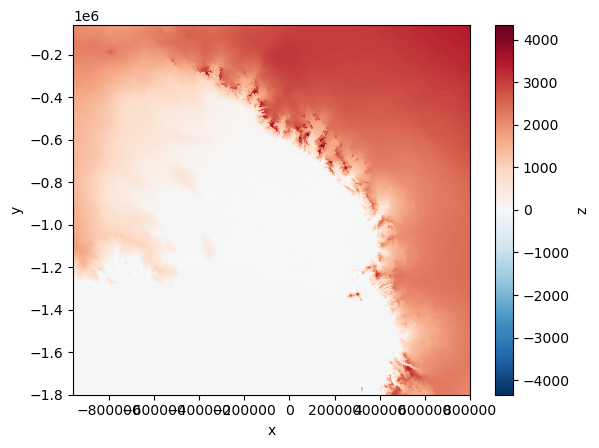

In [23]:
bedmachine_surface.plot()

In [24]:
bedmap2_surface = bedmap2_surface.rename({"x": "easting", "y": "northing"})
bedmachine_surface = bedmachine_surface.rename({"x": "easting", "y": "northing"})
bedmap2_icebase = bedmap2_icebase.rename({"x": "easting", "y": "northing"})
bedmachine_icebase = bedmachine_icebase.rename({"x": "easting", "y": "northing"})
bedmap2_bed = bedmap2_bed.rename({"x": "easting", "y": "northing"})
bedmachine_bed = bedmachine_bed.rename({"x": "easting", "y": "northing"})
bedmachine_bed_full = bedmachine_bed_full.rename({"x": "easting", "y": "northing"})
bedmachine_bed_error = bedmachine_bed_error.rename({"x": "easting", "y": "northing"})
bedmachine_bed_error_full = bedmachine_bed_error_full.rename(
    {"x": "easting", "y": "northing"}
)

In [25]:
# convert to datasets
bedmachine_surface = bedmachine_surface.to_dataset(name="surface")
bedmap2_surface = bedmap2_surface.to_dataset(name="surface")
bedmachine_icebase = bedmachine_icebase.to_dataset(name="icebase")
bedmap2_icebase = bedmap2_icebase.to_dataset(name="icebase")
bedmachine_bed = bedmachine_bed.to_dataset(name="bed")
bedmachine_bed_full = bedmachine_bed_full.to_dataset(name="bed")
bedmap2_bed = bedmap2_bed.to_dataset(name="bed")
bedmachine_bed_error = bedmachine_bed_error.to_dataset(name="bed_error")
bedmachine_bed_error_full = bedmachine_bed_error_full.to_dataset(name="bed_error")

# save to zarr files
bedmap2_surface.to_zarr(
    "../../inversion_layers/bedmap2_surface.zarr",
    encoding={"surface": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmachine_surface.to_zarr(
    "../../inversion_layers/bedmachine_surface.zarr",
    encoding={"surface": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmap2_icebase.to_zarr(
    "../../inversion_layers/bedmap2_icebase.zarr",
    encoding={"icebase": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmachine_icebase.to_zarr(
    "../../inversion_layers/bedmachine_icebase.zarr",
    encoding={"icebase": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmap2_bed.to_zarr(
    "../../inversion_layers/bedmap2_bed.zarr",
    encoding={"bed": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmachine_bed.to_zarr(
    "../../inversion_layers/bedmachine_bed.zarr",
    encoding={"bed": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmachine_bed_full.to_zarr(
    "../../inversion_layers/bedmachine_bed_full.zarr",
    encoding={"bed": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmachine_bed_error.to_zarr(
    "../../inversion_layers/bedmachine_bed_error.zarr",
    encoding={"bed_error": {"compressor": zarr.Blosc()}},
    mode="w",
)
bedmachine_bed_error_full.to_zarr(
    "../../inversion_layers/bedmachine_bed_error_full.zarr",
    encoding={"bed_error": {"compressor": zarr.Blosc()}},
    mode="w",
)

In [26]:
# open zarr files
bedmap2_surface = xr.open_zarr("../../inversion_layers/bedmap2_surface.zarr")["surface"]
bedmachine_surface = xr.open_zarr("../../inversion_layers/bedmachine_surface.zarr")[
    "surface"
]
bedmap2_icebase = xr.open_zarr("../../inversion_layers/bedmap2_icebase.zarr")["icebase"]
bedmachine_icebase = xr.open_zarr("../../inversion_layers/bedmachine_icebase.zarr")[
    "icebase"
]
bedmap2_bed = xr.open_zarr("../../inversion_layers/bedmap2_bed.zarr")["bed"]
bedmachine_bed = xr.open_zarr("../../inversion_layers/bedmachine_bed.zarr")["bed"]
bedmachine_bed_full = xr.open_zarr("../../inversion_layers/bedmachine_bed_full.zarr")[
    "bed"
]

bedmachine_bed_error = xr.open_zarr("../../inversion_layers/bedmachine_bed_error.zarr")[
    "bed_error"
]
bedmachine_bed_error_full = xr.open_zarr(
    "../../inversion_layers/bedmachine_bed_error_full.zarr"
)["bed_error"]

In [27]:
bedmachine_bed_error_full

<xarray.DataArray 'bed_error' (northing: 13333, easting: 13333)> Size: 711MB
dask.array<open_dataset-bed_error, shape=(13333, 13333), dtype=float32, chunksize=(834, 834), chunktype=numpy.ndarray>
Coordinates:
  * easting   (easting) int32 53kB -3333000 -3332500 ... 3332500 3333000
  * northing  (northing) int32 53kB 3333000 3332500 ... -3332500 -3333000
Attributes:
    grid_mapping:  mapping
    long_name:     bed topography/ice thickness error
    source:        Mathieu Morlighem
    units:         meters

In [28]:
bedmap2_bed

<xarray.DataArray 'bed' (northing: 1741, easting: 1761)> Size: 12MB
dask.array<open_dataset-bed, shape=(1741, 1761), dtype=float32, chunksize=(436, 441), chunktype=numpy.ndarray>
Coordinates:
  * easting   (easting) float64 14kB -9.6e+05 -9.59e+05 ... 7.99e+05 8e+05
  * northing  (northing) float64 14kB -1.8e+06 -1.799e+06 ... -6.1e+04 -6e+04

## Basement

### Ross Embayment magnetic basement

In [29]:
# RIS_basement = fetch.basement(
#     region=region,
#     spacing=5000,
#     registration=registration,
# )
# print(utils.get_grid_info(RIS_basement))
# # assert utils.get_grid_info(RIS_basement) == (
# #     5000.0,
# #     [-1560000.0, 1400000.0, -2400000.0, 560000.0],
# #     -8502.59960938,
# #     -492.665466309,
# #     "g",
# # )
# fig = maps.plot_grd(RIS_basement, cmap="vik", grd2cpt=True)
# fig.show()

### ANTASed sediment thickness model

In [30]:
# # get sediment thickness
# ANTASed_sediment_thickness = fetch.sediment_thickness(
#     version="ANTASed",
#     region=region,
#     spacing=5000,
#     registration="g",
# )
# print(utils.get_grid_info(ANTASed_sediment_thickness))
# # assert utils.get_grid_info(ANTASed_sediment_thickness) == (
# #     5000.0,
# #     [-1560000.0, 1400000.0, -1990000.0, 560000.0],
# #     -294.53125,
# #     12430.0,
# #     "g",
# # )

# # subtract antased from bedmachine to get basement depths
# grids = utils.grd_compare(bedmachine_bed_5k, ANTASed_sediment_thickness, plot=False)
# # select the difference grid (first 1)
# ANTASed_basement = grids[0]
# print(utils.get_grid_info(ANTASed_basement))

### Merge ANTASed to RIS Basement

In [ ]:
# # convert magnetic basement dataarray to dataframe
# RIS_basement_xyz = pygmt.grd2xyz(RIS_basement, skiprows=True)
# # re-surface with a 20cell buffer
# RIS_basement_buffer = pygmt.surface(
#     data=RIS_basement_xyz,
#     spacing="5000",
#     region=region,
#     M="20c",
# )

# # mask ANTASed to region outside the buffered magnetic basement
# mask = RIS_basement_buffer.isnull()
# mask_ANTASed = ANTASed_basement.where(mask == 1)

# # merge 2 grids with buffer zone between
# merged = xr.merge([mask_ANTASed, RIS_basement]).z

# # interpolate the gap
# merged=merged.rio.write_nodata("nan")
# merged=merged.rio.write_crs("epsg:3031")
# ANTASed_magnetics_merged_basement = merged.rio.interpolate_na(method="cubic")

# fig = maps.plot_grd(RIS_basement_buffer, cmap="vik", grd2cpt=True)
# fig = maps.plot_grd(merged, cmap="vik", grd2cpt=True, fig=fig, origin_shift="xshift")
# fig = maps.plot_grd(
#     ANTASed_magnetics_merged_basement,
#     cmap="vik",
#     grd2cpt=True,
#     fig=fig,
#     origin_shift="xshift",
# )
# fig.show()

# ANTASed_magnetics_merged_basement = ANTASed_magnetics_merged_basement.to_dataset(
#     name="basement"
# ).drop_vars(["spatial_ref"])

# # save to zarr file
# ANTASed_magnetics_merged_basement.to_zarr(
#     "../../inversion_layers/ANTASed_magnetics_merged_basement.zarr",
#     encoding={"basement": {"compressor": zarr.Blosc()}},
#     mode="w",
# )

### Merge RIS Basement with Bedmachine Bed

In [ ]:
# # mask bed to region outside the buffered magnetic basement
# mask = RIS_basement_buffer.isnull()
# mask_bedmachine_bed = bedmachine_bed_5k.where(mask == 1)

# # merge 2 grids with buffer zone between
# merged = xr.merge([mask_bedmachine_bed, RIS_basement]).z

# # interpolate the gap
# merged=merged.rio.write_nodata("nan")
# merged=merged.rio.write_crs("epsg:3031")
# bed_basement_merged = merged.rio.interpolate_na(method="cubic")

# fig = maps.plot_grd(RIS_basement_buffer, cmap="vik", grd2cpt=True)
# fig = maps.plot_grd(merged, cmap="vik", grd2cpt=True, fig=fig, origin_shift="xshift")
# fig = maps.plot_grd(
#     bed_basement_merged, cmap="vik", grd2cpt=True, fig=fig, origin_shift="xshift"
# )
# fig.show()

# bed_basement_merged = bed_basement_merged.to_dataset(name="basement").drop_vars(
#     ["spatial_ref"]
# )

# # save to zarr file
# bed_basement_merged.to_zarr(
#     "../../inversion_layers/bed_basement_merged.zarr",
#     encoding={"basement": {"compressor": zarr.Blosc()}},
#     mode="w",
# )

### Compare

In [33]:
# ANTASed_magnetics_merged_basement = xr.open_zarr(
#     "../../inversion_layers/ANTASed_magnetics_merged_basement.zarr"
# )["basement"]
# ANTASed_magnetics_merged_basement

In [35]:
# bed_basement_merged = xr.open_zarr("../../inversion_layers/bed_basement_merged.zarr")[
#     "basement"
# ]
# bed_basement_merged

In [34]:
# grids = utils.grd_compare(
#     ANTASed_magnetics_merged_basement,
#     bed_basement_merged,
#     plot=True,
# )

## Moho

### An et al. 2015

In [36]:
# An_moho = fetch.moho(
#     version="an-2015",
#     region=region,
#     spacing=5000,
#     registration=registration,
# )
# print(utils.get_grid_info(An_moho))
# # assert utils.get_grid_info(An_moho) == (
# #     5000.0,
# #     [-1560000.0, 1400000.0, -2400000.0, 560000.0],
# #     -65036.3632812,
# #     -7473.28857422,
# #     "g",
# # )

# An_moho_rel_to_bed = fetch.resample_grid(bedmachine_surface, spacing=5e3) + An_moho
# print(utils.get_grid_info(An_moho_rel_to_bed))
# # assert utils.get_grid_info(An_moho_rel_to_bed) == (
# #     5000.0,
# #     [-1560000.0, 1400000.0, -2400000.0, 560000.0],
# #     -61256.7382812,
# #     -7529.28857422,
# #     "g",
# # )
# fig = maps.plot_grd(An_moho, cmap="vik", grd2cpt=True)
# fig = maps.plot_grd(
#     An_moho_rel_to_bed, cmap="vik", grd2cpt=True, fig=fig, origin_shift="xshift"
# )
# fig.show()

### Shen et al. 2018

In [37]:
# Shen_moho = fetch.moho(
#     version="shen-2018",
#     region=region,
#     spacing=5000,
#     registration="g",
# )
# print(utils.get_grid_info(Shen_moho))
# # assert utils.get_grid_info(Shen_moho) == (
# #     5000.0,
# #     [-1560000.0, 1400000.0, -2400000.0, 560000.0],
# #     -57238.3164062,
# #     -17217.0976562,
# #     "g",
# # )

# Shen_moho_rel_to_bed = fetch.resample_grid(bedmachine_surface, spacing=5e3) + Shen_moho
# print(utils.get_grid_info(Shen_moho_rel_to_bed))
# # assert utils.get_grid_info(Shen_moho_rel_to_bed) == (
# #     5000.0,
# #     [-1560000.0, 1400000.0, -2400000.0, 560000.0],
# #     -53469.4023438,
# #     -16993.6015625,
# #     "g",
# # )
# fig = maps.plot_grd(Shen_moho, cmap="vik", grd2cpt=True)
# fig = maps.plot_grd(
#     Shen_moho_rel_to_bed, cmap="vik", grd2cpt=True, fig=fig, origin_shift="xshift"
# )
# fig.show()

# rosetta ice thickness

In [38]:
# file_path = pooch.retrieve(
#     # URL to one of Pooch's test files
#     url="http://wonder.ldeo.columbia.edu/data/ROSETTA-Ice/DerivedProducts/DICE_IceThickness/rs_2019_DICE_Ice_Thickness.txt",
#     known_hash="5dc63064ef32bfdd0f83b506bc8a1241b2bbad62d54ca7151bda4b66f6320695",
# )
# ice = pd.read_csv(file_path)
# file_path

# rosetta density model

In [39]:
# file_path = pooch.retrieve(
#     # URL to one of Pooch's test files
#     url="http://wonder.ldeo.columbia.edu/data/ROSETTA-Ice/DerivedProducts/Density/rs_2019_density.csv",
#     known_hash="8c3d6f69087095ab1a184d0517a136ebd59e4761110601b30da1ef3685883617",
# )
# density = pd.read_csv(file_path)